# Topo map comparison

Compare IGN, SwissTopo, Kompass, Bugianen, and various OSM maps,accross the alps

In [24]:
%load_ext autoreload
%autoreload 2

import os
NBROOT = os.path.realpath(os.curdir)

import sys
sys.path.append(os.path.realpath('..'))
sys.path.append(os.path.realpath('../../eslope/development'))

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [4]:
# Preamble

import logging
logging.basicConfig(level=logging.DEBUG)
logging.getLogger('PIL').level = logging.INFO # PIL.PngImagePlugin

from dataclasses import astuple

import os
from os.path import exists, join as pjoin, realpath, expanduser
import sqlite3
from pathlib import Path
from time import time
from urllib.error import HTTPError
from urllib.request import urlopen, urlretrieve

#external
from IPython.display import display, Image
from PIL import Image as Img
import mercantile as T

import mbt_util as M
import bbox as BB
from src import img_util as G

In [5]:
dir = 'geo/data/sample_topo'
os.makedirs(dir, exist_ok=True)
%cd $dir

/home/me/code/eddy-geek/TIL/geo/data/sample_topo


In [6]:
os.makedirs('tiles', exist_ok=True)

In [41]:
from random import randint

def ch_url(tileset, format):  # only landeskarte-10 is png
    return lambda z, x, y: f'https://wmts100.geo.admin.ch/1.0.0/ch.swisstopo.{tileset}/default/current/3857/{z}/{x}/{y}.{format}'

def scale2tileset(scale):
    if scale==10:
        return 'landeskarte-farbe-10', 'png'
    else:
        assert scale in (25, 50, 100, 200, 500, 1000, 10000)
        return f'pixelkarte-farbe-pk{scale}.noscale', 'jpeg'

def geturl_ch_downsampled(z, x, y):
    return ch_url(*scale2tileset(dw_tilescale[z]))(z, x, y)

dw_tilescale = [1000]*9 + [1000, 1000, 500, 200, 100, 50, 25, 10]

def ignweburl(z, x, y):
    # for top25 zoomed out: =GEOGRAPHICALGRIDSYSTEMS.MAPS.SCAN25TOUR
    return ( 'https://wxs.ign.fr/8jdgffs9i650h6hukfxdip4v/geoportail/wmts?'
             'Layer=GEOGRAPHICALGRIDSYSTEMS.MAPS&Style=normal&TileMatrixSet=PM&SERVICE=WMTS&'
            f'REQUEST=GetTile&VERSION=1.0.0&FORMAT=image/jpeg&TileMatrix={z}&TileCol={x}&TileRow={y}')


datasets = {
    'bugianen':   expanduser('~/Downloads/dwnmaps/mapdata/mbtiles/Bugianen/Bugianen.mbtiles'),
    'kompass':    expanduser('~/Downloads/dwnmaps/mapsoft/MOBAC-2.1.4/atlases/Kompass_dolo.mbtiles'),
    'chdzsw':     '../sample_ch/chsw.mbtiles',
    'chdzsc':     '../sample_ch/chsc.mbtiles',
    'chdzse':     '../sample_ch/chse.mbtiles',
    'chdzc':      '../sample_ch/chc.mbtiles',
    'chdzweb':    geturl_ch_downsampled,
    'chweb':      ch_url('pixelkarte-farbe', 'jpeg'),
    'cyclosm':    lambda z, x, y: f'https://c.tile-cyclosm.openstreetmap.fr/cyclosm/{z}/{x}/{y}.png',
    'kompassweb': lambda z, x, y: f'http://ec{randint(0, 3)}.cdn.ecmaps.de/WmsGateway.ashx.jpg?Experience=ecmaps&MapStyle=KOMPASS%20Touristik&TileX={x}&TileY={y}&ZoomLevel={z}',
    'ignweb':     ignweburl,
    'ocm':        lambda z, x, y: (f'https://a.tile.opencyclemap.org/cycle/{z}/{x}/{y}.png', 'http://www.openstreetmap.org/'),
    'mri':        lambda z, x, y: f'https://maps.refuges.info/hiking/{z}/{x}/{y}.png',
    'otm':        lambda z, x, y: f'https://c.tile.opentopomap.org/{z}/{x}/{y}.png',
    '4umaps':     lambda z, x, y: f'https://tileserver.4umaps.com/{z}/{x}/{y}.png',
}

def makepy(dname, llname, zooms=range(9, 17)):
    ll = getattr(BB, 'll'+llname)  # eg BB.lldolo
    src = datasets[dname]
    makepyfun = M.tile_pyramid if isinstance(src, str) else G.tile_pyramid_url
    makepyfun(f'{llname}_{dname}.jpeg', ll, src, zooms)
    return Image(filename=f'{llname}_{dname}.jpeg')


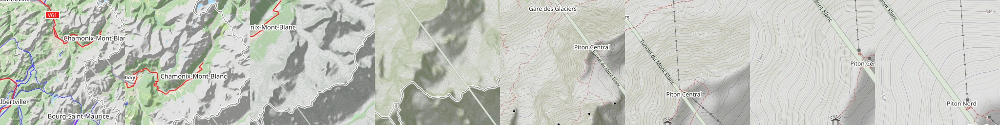

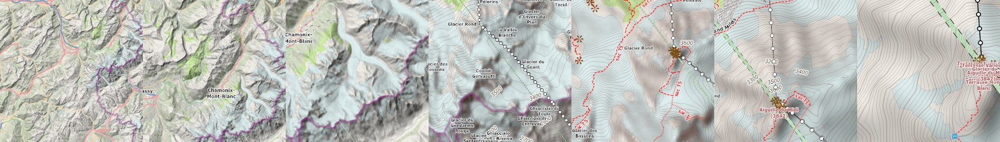

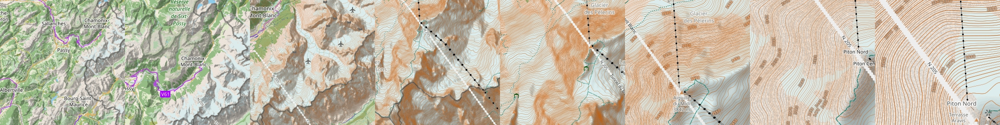

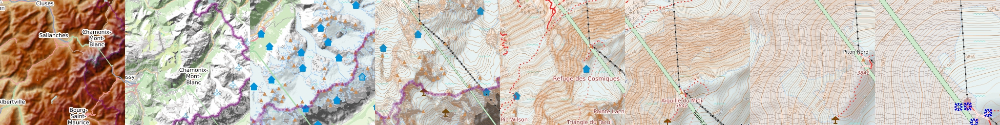

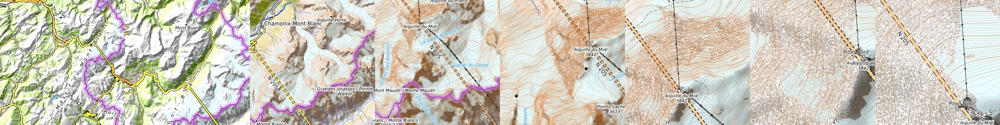

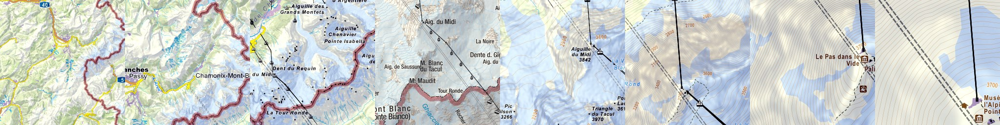

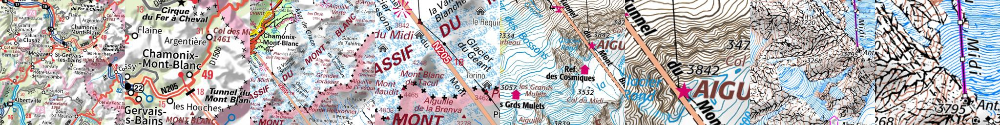

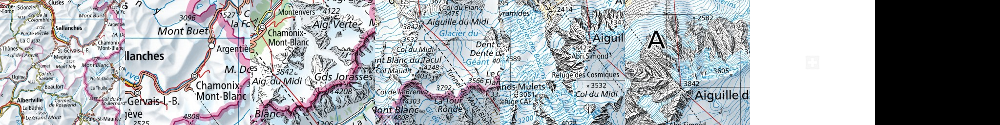

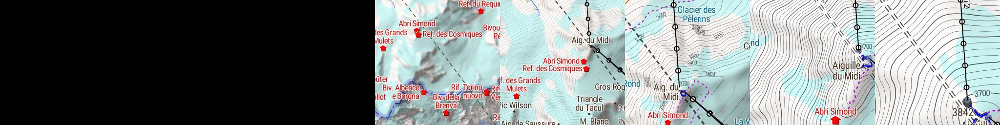

In [40]:
for dname in 'ocm', '4umaps', 'cyclosm', 'mri', 'otm', 'kompassweb', 'ignweb', 'chdzweb', 'bugianen' :
    display(makepy(dname, 'midi'))

* SwissTopo is the best at every zoom level.
  * Unfortunately it stops at z14 here, but even using the "not dezoomed" tile as z15 gives acceptable results, see below
  * It main drawback not visible here is low visibility of hiking path, but we can remediate that with overlays.
* Kompass even in this "degraded mode" (see later the real kompass) holds its own quite well at z11-z14
* IGN is hampered by its too few zoom levels, ie z9/11 are a bit cramped whike z10/12 are much too big
  * (Only in this single example, IGN z10 has more inforation that SwissTopo)
* Bugianen 2005 "degraded mode" is not convincing (but still miles ahead of OSM)
* Amongst all the OSM variants,
  * OpenTopoMap is the least bad (still does not show huts that well, should drop contour lines at z11/12)
  * OpenCycleMap manages more names sometimes but is often worse.
  * 4UMaps has different names
  * We'll skip the others from now on.

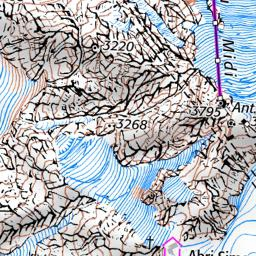

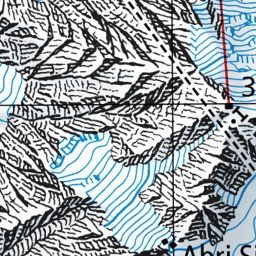

In [90]:
# filling in Swisstopo z15 is ok:
for dname in 'ignweb', 'chweb':
    display(makepy(dname, 'midi', zooms=[15]))

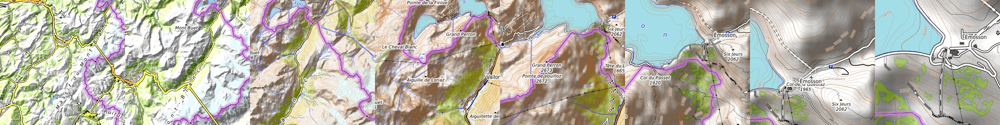

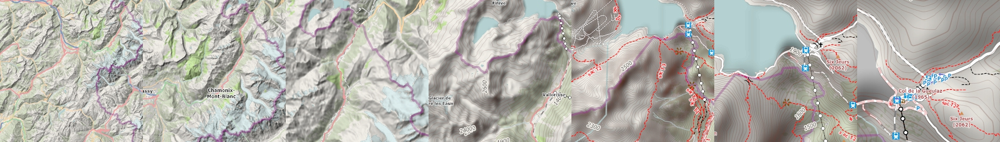

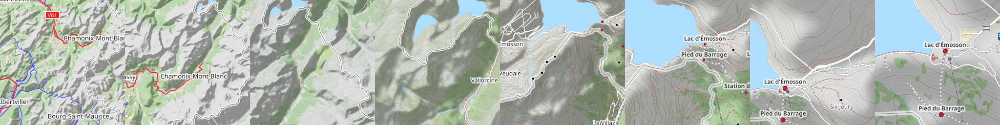

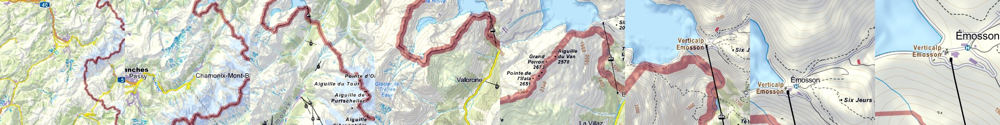

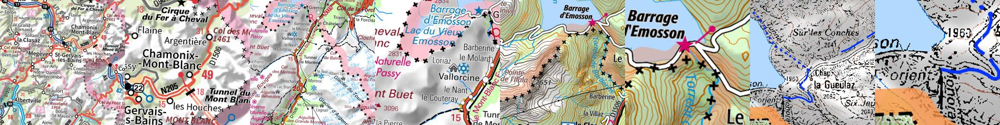

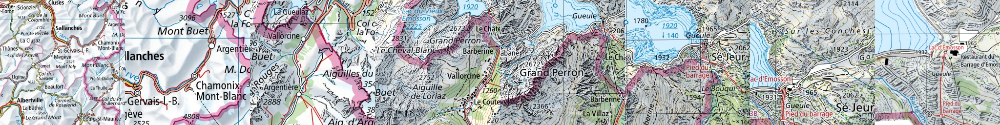

In [45]:
for dname in 'otm', '4umaps', 'ocm', 'kompassweb', 'ignweb', 'chdzweb' :
    display(makepy(dname, 'emosson'))

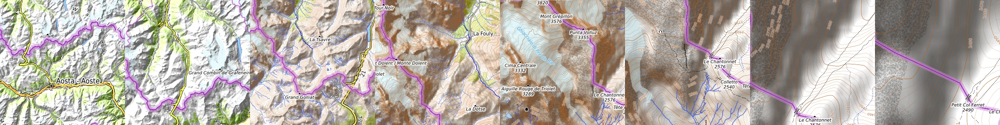

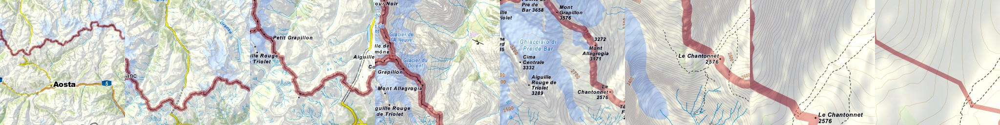

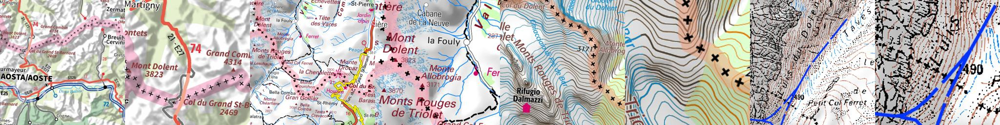

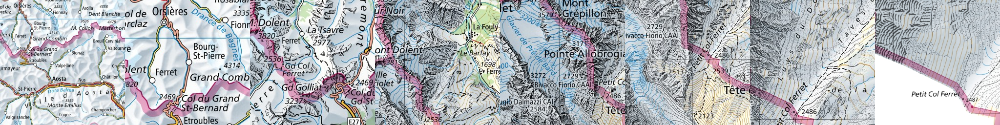

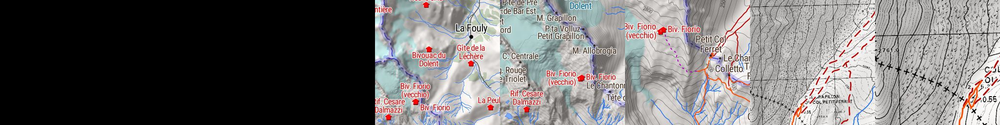

In [44]:
for dname in 'otm', 'kompassweb', 'ignweb', 'chdzweb', 'bugianen':
    display(makepy(dname, 'ferret'))

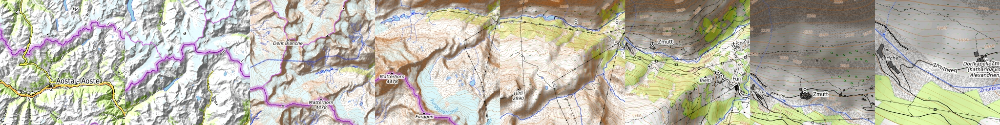

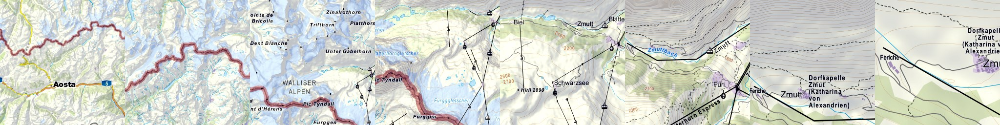

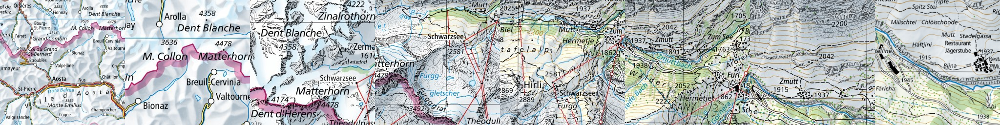

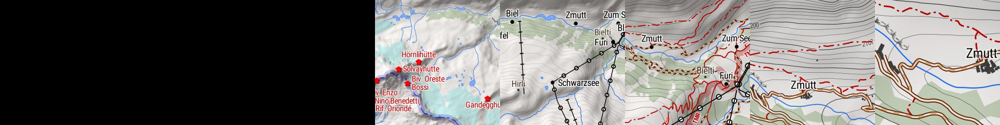

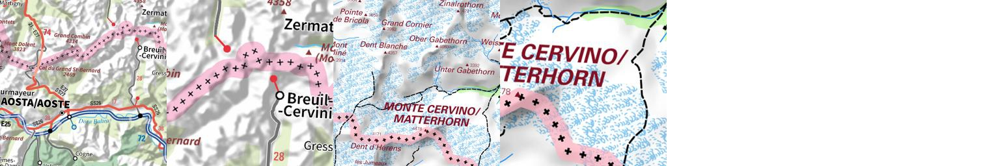

In [31]:
for dname in 'otm', 'kompassweb', 'chdzweb', 'bugianen', 'ignweb' :
    display(makepy(dname, 'zmutt'))

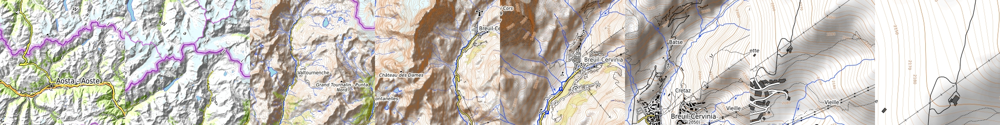

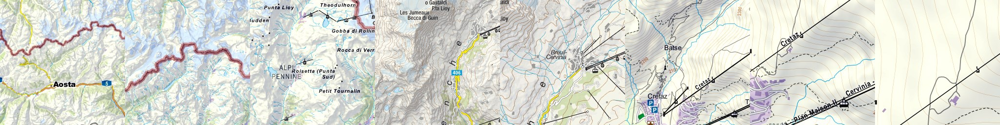

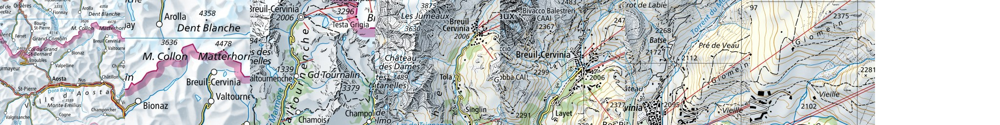

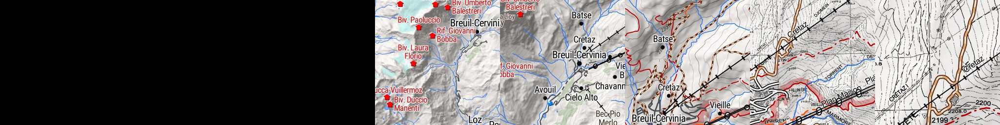

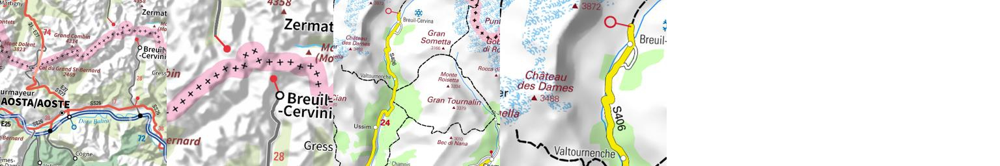

In [33]:
for dname in 'otm', 'kompassweb', 'chdzweb', 'bugianen', 'ignweb' :
    display(makepy(dname, 'breuil'))

Again we can play the zoom levels to fill the SwissTopo hole:

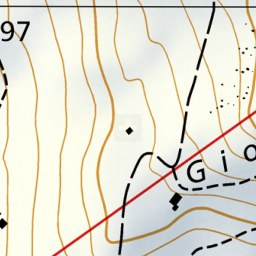

In [8]:
display(makepy('chweb', 'breuil', zooms=[16]))

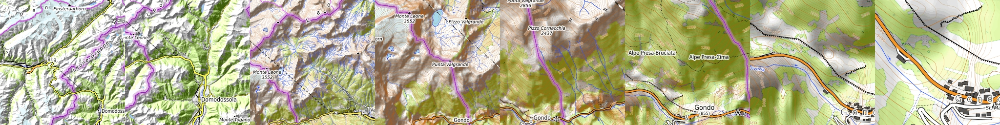

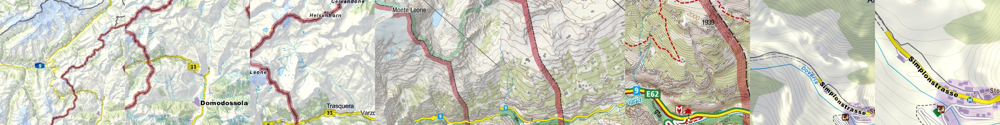

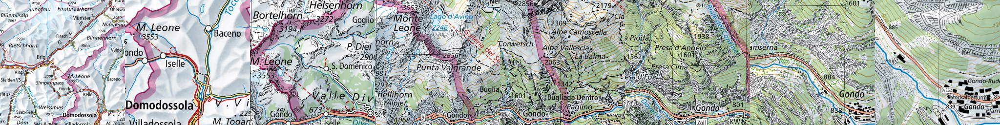

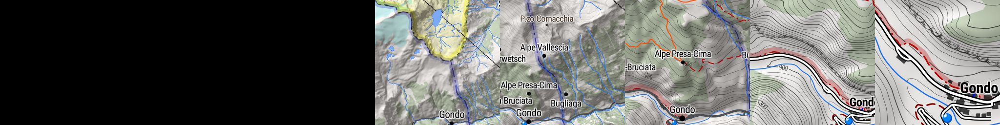

In [35]:
for dname in 'otm', 'kompassweb', 'chdzweb', 'bugianen':
    display(makepy(dname, 'gondo'))

* we finally enter kompass "core" territory, although z15/16 are still lacking
* ...and we get out of IGN z11 coverage

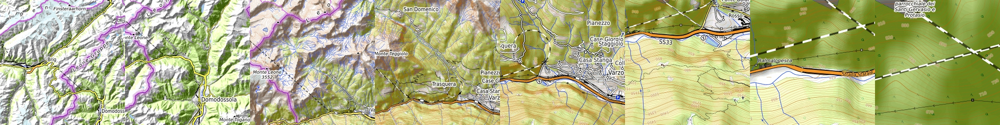

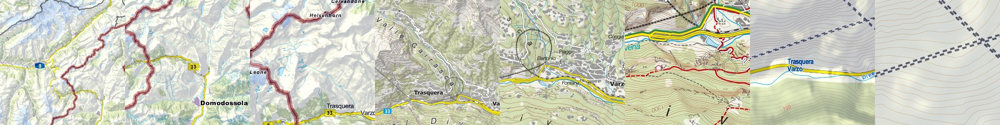

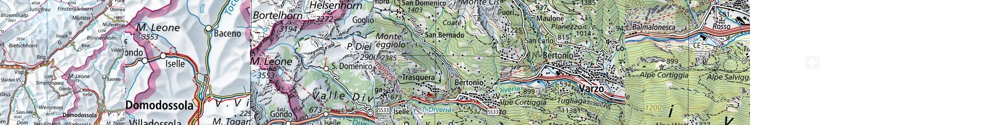

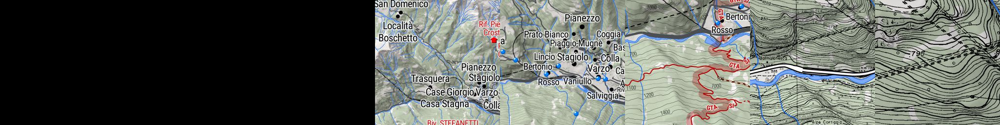

In [37]:
for dname in 'otm', 'kompassweb', 'chdzweb', 'bugianen':
    display(makepy(dname, 'trasquera'))

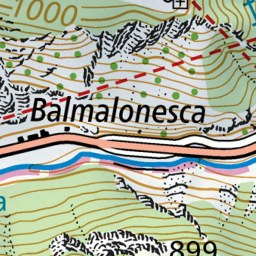

In [16]:
# and again swisstopo un-dezoomed is amongst the best:
display(makepy('chweb', 'trasquera', zooms=[15]))

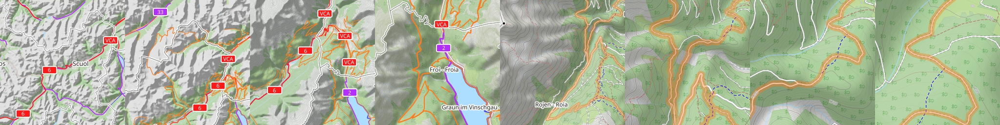

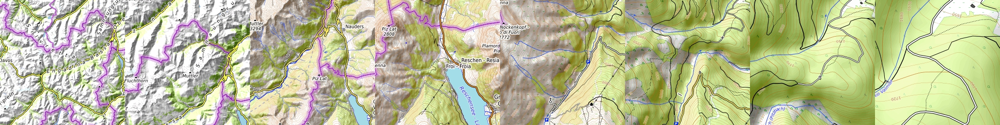

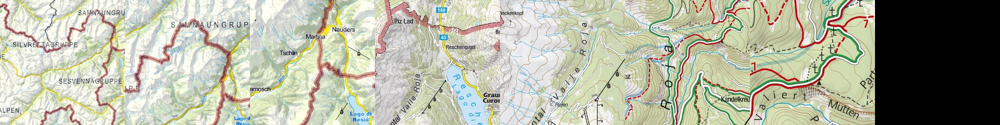

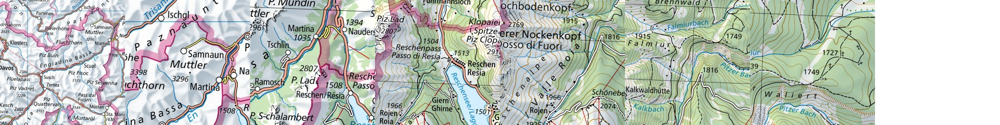

In [38]:
for dname in 'ocm', 'otm', 'kompass', 'chdzc', :
    display(makepy(dname, 'resia'))
